# Analysis Part 1

### Import libraries

In [1]:
%run utils.py

In [2]:
import gpxpy
import pandas as pd
import geopandas as gpd
import movingpandas as mpd
import matplotlib.pyplot as plt
import folium
from datetime import datetime, timedelta
from geopy.geocoders import Nominatim 
from utils import plot_tracks
import warnings
warnings.filterwarnings('ignore') # ignore warnings

Load the cleaned data.

In [3]:
df = pd.read_csv('df_cleaned.csv')
df.head()

,_id,length_3d,user,start_time,max_elevation,bounds,uphill,moving_time,end_time,max_speed,gpx,difficulty,min_elevation,url,downhill,name,length_2d,avg_speed,difficulty_num,country
0,5afb229e8f80884aaad9c6ea,10832.953016,Bergfritz,2018-05-11 07:37:40,1934.47,"{'min': {'type': 'Point', 'coordinates': [13.2...",612.880,12155.0,2018-05-11 11:38:23,1.595493,"<?xml version=""1.0"" encoding=""UTF-8""?>\n<gpx x...",T2 - Mountain hike,1322.96,http://www.hikr.org/tour/post131855.html,609.670,"Remsteinkopf, 1945 m",10832.953016,0.891234,2,Österreich
1,5afb229e8f80884aaad9c6eb,12259.376315,Bergfritz,2018-05-12 07:25:08,2186.21,"{'min': {'type': 'Point', 'coordinates': [13.1...",614.753,13876.0,2018-05-12 12:08:28,1.394320,"<?xml version=""1.0"" encoding=""UTF-8""?>\n<gpx x...",T3 - Difficult Mountain hike,1266.40,http://www.hikr.org/tour/post131856.html,1193.733,"Schuhflicker, 2214 m",12259.376315,0.883495,3,Österreich
2,5afb229e8f80884aaad9c6ee,19581.273819,rkroebl,2018-05-11 05:44:58,697.57,"{'min': {'type': 'Point', 'coordinates': [8.61...",310.662,18197.0,2018-05-11 12:54:25,1.542405,"<?xml version=""1.0"" encoding=""UTF-8""?>\n<gpx x...",T2 - Mountain hike,438.50,http://www.hikr.org/tour/post131845.html,305.372,Waldstätterweg: Buochs - Beckenried und Gersau...,19581.273819,1.076072,2,Switzerland
3,5afb229e8f80884aaad9c6ef,8927.813277,siso,2018-05-12 04:28:16,2613.96,"{'min': {'type': 'Point', 'coordinates': [8.83...",922.870,10905.0,2018-05-12 13:46:34,3.859908,"<?xml version=""1.0"" encoding=""UTF-8""?>\n<gpx x...",T1 - Valley hike,1685.33,http://www.hikr.org/tour/post131818.html,927.190,Pizzo d’Era (2618 m) – Skitour,8927.813277,0.818690,1,Switzerland
4,5afb229e8f80884aaad9c6f0,8925.378850,ivanbutti,2018-05-12 05:08:25,1666.58,"{'min': {'type': 'Point', 'coordinates': [9.44...",1032.625,14660.0,2018-05-12 10:04:34,4.073263,"<?xml version=""1.0"" encoding=""UTF-8""?>\n<gpx x...",T3+ - Difficult Mountain hike,682.73,http://www.hikr.org/tour/post131816.html,1009.965,Mattinata sul Due Mani,8925.378850,0.608825,3,Italia


Create some new usefull columns.

In [4]:
# find the season for each track, winter (21/12 - 20/03), spring (21/03 - 20/06), summer (21/06 - 20/09), autumn (21/09 - 20/12)
df['season'] = df['start_time'].map(lambda x: 'winter' if (x[5:7] == '12' or x[5:7] == '01' or x[5:7] == '02') else ('spring' if (x[5:7] == '03' or x[5:7] == '04' or x[5:7] == '05') else ('summer' if (x[5:7] == '06' or x[5:7] == '07' or x[5:7] == '08') else 'autumn')))
df['season'].value_counts()

summer    1876
autumn    1677
spring    1160
winter     885
Name: season, dtype: int64

In [5]:
# find the year for each track
df['year'] = df['start_time'].map(lambda x: x[0:4])
df['year'].value_counts()

2015    1415
2016    1414
2017    1152
2014    1027
2013     289
2018     259
2012      21
2011      15
2010       5
2009       1
Name: year, dtype: int64

In [6]:
# find the longest hike
longest_hike = df[df['length_3d'] == df['length_3d'].max()]
longest_hike

,_id,length_3d,user,start_time,max_elevation,bounds,uphill,moving_time,end_time,max_speed,...,min_elevation,url,downhill,name,length_2d,avg_speed,difficulty_num,country,season,year
503,5afb22dd8f80884aaad9ca50,19996.526438,Poge,2017-10-04 05:51:25,2186.06,"{'min': {'type': 'Point', 'coordinates': [9.49...",1989.233,21978.0,2017-10-04 13:13:44,1.400316,...,606.71,http://www.hikr.org/tour/post125865.html,1989.743,"Cima delle Miniere, Zuc di Valbona, Zucco di Cam",19996.526438,0.909843,4,Italia,autumn,2017


In [7]:
first_hike = df[df['start_time'] == df['start_time'].min()]
last_hike = df[df['start_time'] == df['start_time'].max()]
last_hike

,_id,length_3d,user,start_time,max_elevation,bounds,uphill,moving_time,end_time,max_speed,...,min_elevation,url,downhill,name,length_2d,avg_speed,difficulty_num,country,season,year
3750,5afb245a8f80884aaad9de8d,10831.413653,paoloski,2018-05-13 06:25:05,1493.0,"{'min': {'type': 'Point', 'coordinates': [8.90...",618.8,10858.0,2018-05-13 09:39:54,1.985246,...,890.0,http://www.hikr.org/tour/post131887.html,648.8,Monte Ferraro,10831.413653,0.997551,2,Switzerland,spring,2018


In [8]:
# find the user with the most hikes
df['user'].value_counts()

ser59         219
cristina      211
Menek         201
Riosambesi    169
Poge          129
             ... 
rbaumann        1
Sascha78        1
HartwigB        1
xaendi          1
zen6363         1
Name: user, Length: 291, dtype: int64

## Example of hike
Let's see an example of a hike. We can plot the path of the hike, and the speed for each point.

In [9]:
gpx = gpxpy.parse(longest_hike['gpx'].values[0])

track = gpx.tracks[0]
segment = track.segments[0]
# Load the data into a Pandas dataframe (by way of a list)
data = []
segment_length = segment.length_3d()
for point_idx, point in enumerate(segment.points):
    data.append([point.longitude, point.latitude,point.elevation,
point.time, segment.get_speed(point_idx)])
columns = ['Longitude', 'Latitude', 'Altitude', 'Time', 'Speed']
gpx_df = pd.DataFrame(data, columns=columns)

df_gpx = gpx_df.set_index('Time')

#2(make points tuple for line)
points = []
for track in gpx.tracks:
    for segment in track.segments: 
        for point in segment.points:
            points.append(tuple([point.latitude, point.longitude]))

start_point = data[0]
end_point = data[-1]
# travel time
# steps to calcolate the difference of time from the timestamp in the first point to the last.
travel_time = end_point[3]-start_point[3]
travel_time_seconds = timedelta(seconds=travel_time.total_seconds())
travel_time_hours = str(timedelta(seconds=travel_time_seconds.seconds))
print_travel_time = travel_time_hours.split(':')
print("travel time %sh %s' %s''" % (print_travel_time[0], print_travel_time[1], print_travel_time[2]))

travel time 7h 22' 19''


In [10]:
latlon = str(start_point[1]) + "," + str(start_point[0])
geolocator = Nominatim(user_agent="geospatial course unitn")
starting_place = geolocator.reverse(latlon)
starting_place

Location(Introbio, Piazza Carrobio, Introbio, Lecco, Lombardia, 23815, Italia, (45.9706164, 9.453488, 0.0))

In [11]:
latlon = str(end_point[1]) + "," + str(end_point[0])
geolocator = Nominatim(user_agent="geospatial course unitn")
arrival_place = geolocator.reverse(latlon)
arrival_place

Location(Introbio, Piazza Carrobio, Introbio, Lecco, Lombardia, 23815, Italia, (45.9706164, 9.453488, 0.0))

Pass the data to a GeoDataFrame.

In [12]:
# GeoDataFrame for MovingPandas
geo_df = gpd.GeoDataFrame(df_gpx, 
crs=4326,
geometry= gpd.points_from_xy(df_gpx.Longitude, df_gpx.Latitude, df_gpx.Altitude))

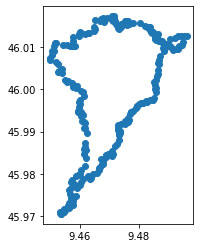

In [13]:
geo_df.plot()
plt.show()

Create a trajectory plot.

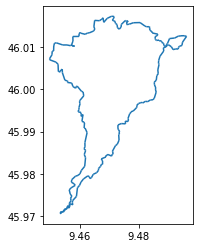

In [14]:
# object trajectory from MovingPandas
trajectory = mpd.Trajectory(geo_df, 1)
trajectory.plot()
plt.show()

Let's add the speed to the plot.

In [15]:
trajectory.add_speed(overwrite=True)

In [16]:
# conversion m/s to km/h
def ms_to_km(ms):
    v = (ms) * (60*60)/1000
    return v

In [17]:
trajectory.df['kmh'] = trajectory.df['speed'].apply(ms_to_km)

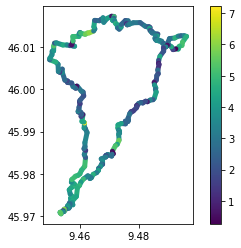

In [18]:
trajectory.plot(column="kmh", linewidth=5, capstyle='round', legend=True)
plt.show()

Extracting trajectory segments based on time.

In [19]:
segment_clip = trajectory.get_segment_between(datetime(2017,10,4,11,36,1),datetime(2027,10,4,12,36,1))

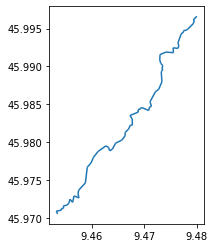

In [20]:
segment_clip.plot()
plt.show()

### Plot the example in with folium.

In [21]:
mymap = folium.Map( location=[ df_gpx.Latitude.mean(), df_gpx.Longitude.mean() ], zoom_start=11, tiles=None)
folium.TileLayer('openstreetmap', name='OpenStreet Map').add_to(mymap)
folium.TileLayer('https://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/tile/{z}/{y}/{x}', attr='Tiles &copy; Esri &mdash; National Geographic, Esri, DeLorme, NAVTEQ, UNEP-WCMC, USGS, NASA, ESA, METI, NRCAN, GEBCO, NOAA, iPC', name='Nat Geo Map').add_to(mymap)
folium.TileLayer('http://tile.stamen.com/terrain/{z}/{x}/{y}.jpg', attr='terrain-bcg', name='Terrain Map').add_to(mymap)

In [22]:
folium.PolyLine(points, color='red', weight=4.5, opacity=.5).add_to(mymap)

In [23]:
mymap

Let's now plot all the trajectories in a map. We can see that the large majority of the trajectories are in the Alps.

In [24]:
map = plot_tracks(df)
map